In [5]:
import os
import re
import gzip
from typing import List
import shutil
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.basemap import Basemap
import netCDF4 as nc
import requests
import sys 

sys.path.insert(0, os.path.abspath("."))

from directory_paths import project_dir, temp_dir, plot_dir, illegal_char

ModuleNotFoundError: No module named 'directory_paths'

## Development


In [3]:
test = 'pub/iono_daily/gim_for_research'

re.split(r'/', test)[-1]

'gim_for_research'

In [4]:
def isleap(year:int)->bool:
    ''' Function to check if a year is a leap year '''    
    
    if year > 1582: # Gregorian Calendar
        return (year % 4 == 0 and year % 100 != 0 or year % 400 == 0)
    else:           # Julian Calendar
        return (year % 4 == 0)

def get_day_num(date:List)->int:
    ''' Function to get the number of days since the first of january of that year '''

    # initialise days of month
    months = [31, 28, 31, 30, 31, 30, 31, 31, 30, 31, 30, 31]

    if isleap(date[-1]):
        months[1] = 29

    day = 0
    for i in range(date[1]-1):
        day += months[i]
    day += date[0]
    return day

def get_timeslot(time:List):
    ''' 
    Function to return the nearest time slot (of TEC map) for a given time.
    If the time matches exactly with the 
    

    TODO: work for a time resolution
    '''
    tim1 = 4*time[0] + time[1]//15 
    tim2 = tim1 +1

    if time[1]%15 == 0:
        return tim1

    if time[1]%15 != 0:
        return np.array([tim1, tim2])

def download_file(url:str, save_dir:str='temp', unzip:bool=False):
    ''' 
    Function to download a file from a url. Adapted from :
    https://realpython.com/python-download-file-from-url/#saving-downloaded-content-to-a-file
    
    Parameters
    ----------
    url: STR 
        Specify url in a string
    save_dir : STR
        Specify relative path for the downloaded file

    Returns
    -------
    None
    '''

    # crete save directory if not available
    main_dir = os.path.dirname(os.path.realpath('__file__')) 
    save_dir = os.path.join(main_dir, save_dir)
    if not os.path.exists(save_dir):
        os.mkdir(save_dir)
    
    # download file
    response = requests.get(url)
    
    if "content-disposition" in response.headers:
        content_disposition = response.headers["content-disposition"]
        filename = content_disposition.split("filename=")[1]
    else:
        filename = url.split("/")[-1]
    
    with open(os.path.join(save_dir, filename), mode="wb") as file:
        file.write(response.content)

    print(f"Downloaded file {filename}")

    if unzip:
        decompress(os.path.join(save_dir, filename), os.path.join(save_dir, os.path.splitext(filename)[0]))
        
def decompress(infile, outfile):
    ''' 
    Function to decompress a .gz file. Copied from:
    https://docs.python.org/2/library/gzip.html#examples-of-usage
    
    Parameters
    ----------
    infile: STR
        Path of .gz file
    outfile: STR
        Path of extracted file
    
    Returns
    -------
    None
    '''
    with gzip.open(infile, 'rb') as f_in, open(outfile, 'wb') as f_out:
        shutil.copyfileobj(f_in, f_out)
        print(f'Decompressed file {re.split(r'\\', outfile)[-1]}')

def construct_url(time_date:str, time_res:int=0, url_base:str=r'https://sideshow.jpl.nasa.gov/pub/iono_daily/gim_for_research/'):
    '''
    TODO: documentation
    TODO: improve time_res input
    '''

    time_res =  0

    if time_res == 0:   jpl_type = 'jpli'
    elif time_res == 1: jpl_type = 'jpld'

    url_base += f'{jpl_type}/'

    date = split_time_date(time_date)[1]
    # filename format jpliDOY0.YYi.nc
    fname = f'{jpl_type}{get_day_num(date):>03}0.{str(date[2])[-2:]}i.nc.gz'

    url = f'{url_base}/{date[2]}/{fname}'
    
    return fname, url

def split_time_date(time_date):
    time, date = time_date.split()
    time = [int(i) for i in re.split(r'[:.,]', time)]
    date = [int(i) for i in re.split(r'[-.,/]', date)]
    return time, date

def array_coord(lat, lon):
    row = -lat + 89.5
    column = lon + 179.5
    return (row, column)

def get_time(timeslot:int, rtype='int'):
    tot_minutes = 15 * timeslot
    hours = tot_minutes//60
    minutes = tot_minutes - hours*60

    if rtype=='int':
        if not isinstance(timeslot, int):
            return [f'{hours[i]:>02}:{minutes[i]:>02}' for i in range(len(timeslot))]
        else:
            return f'{hours:>02}:{minutes:>02}'
    elif rtype=='array':
        if not isinstance(timeslot, int):
            return [[hours[i], minutes[i]] for i in range(len(timeslot))]
        else:
            return [hours, minutes]


In [18]:
date = [1, 1, 4]

f'{str(date[2])[-2:]:>02}'

'04'

In [28]:
time_date = '11:25 13/07/2017'
time_res = 0
plot = True
# def get_TEC(time_date, time_res, plot=False):


# initialise save and main directory
save_dir = 'temp'
main_dir = os.path.dirname(os.path.realpath('__file__')) 

fname, url = construct_url(time_date, time_res)
download_file(url, save_dir=save_dir, unzip=True)

file_path = os.path.join(main_dir, save_dir, os.path.splitext(fname)[0])
print(f'File correctly downloaded: {os.path.isfile(file_path)}')

ds = nc.Dataset(file_path)

og_time = split_time_date(time_date)[0]
timeslots = get_timeslot(og_time)
times = get_time(timeslots)


tec_map = ds['tecmap'][timeslots, :].data


# if plot: plot_TEC(tec_map, time_date)

Downloaded file jpli1940.17i.nc.gz
Decompressed file jpli1940.17i.nc
File correctly downloaded: True


In [29]:
tec_map, times

(array([[[7.7, 7.7, 7.7, ..., 7.7, 7.7, 7.7],
         [7.6, 7.6, 7.6, ..., 7.6, 7.6, 7.6],
         [7.6, 7.6, 7.6, ..., 7.6, 7.6, 7.6],
         ...,
         [0.6, 0.6, 0.6, ..., 0.6, 0.6, 0.6],
         [0.6, 0.6, 0.6, ..., 0.6, 0.6, 0.6],
         [0.7, 0.7, 0.7, ..., 0.7, 0.7, 0.7]],
 
        [[8. , 8. , 8. , ..., 8. , 8. , 8. ],
         [7.9, 7.9, 7.9, ..., 7.9, 7.9, 7.9],
         [7.8, 7.8, 7.8, ..., 7.8, 7.8, 7.8],
         ...,
         [0.6, 0.6, 0.6, ..., 0.6, 0.6, 0.6],
         [0.6, 0.6, 0.6, ..., 0.6, 0.6, 0.6],
         [0.7, 0.7, 0.7, ..., 0.7, 0.7, 0.7]]], dtype=float32),
 ['11:15', '11:30'])

In [13]:
def no_iplot(func):
    '''Decorator to turn off and on the interactive mode in matplotlib'''
    def wrapper(*args, **kwargs):
        plt.ioff()
        func(*args, **kwargs)
        plt.ion()
    return wrapper

@no_iplot
def plot_TEC(tec_map, time_date, grid=False, plot_fit=True, save_fig=False, fpath=plot_dir, fname='default'):
    lat_ = np.arange(-89.5, 89.6)
    lon_ = np.arange(-179.5, 179.6)
    lat, lon = np.meshgrid(lat_, lon_)
    title_pad = 6
    cbar_pad = '2%'

    fig, ax = plt.subplots(figsize=(14, 8))
    earth = Basemap()
    cntr = earth.contourf(lon, lat, tec_map.T, levels=100, cmap="RdBu_r", latlon=True, vmin=0, vmax=27)
    earth.drawcoastlines(color='#555566', linewidth=0.5)

    if grid:
        title_pad = 30
        cbar_pad = '8%'
        grid_style = {'linewidth': 0.2, 'dashes':[1,0], 'labels':[1, 1, 1, 1], 'labelstyle':'+/-'}
        earth.drawmeridians(np.arange(-180, 181, 20), **grid_style)
        earth.drawparallels(np.arange(-90, 91, 30), **grid_style)
    
    ax.set_title(f'TEC Map {time_date}', pad=title_pad)
    earth.colorbar(cntr, ax=ax, label=f'TEC (TECU)', pad=cbar_pad, size='2%')

    if save_fig:
        if fname == 'default':
            fname = f'TEC Map {time_date}.png'
            fname = re.sub(illegal_char, '-', fname)
        
        plt.savefig(os.path.join(fpath, fname), dpi=200)

IndexError: index exceeds dimension bounds

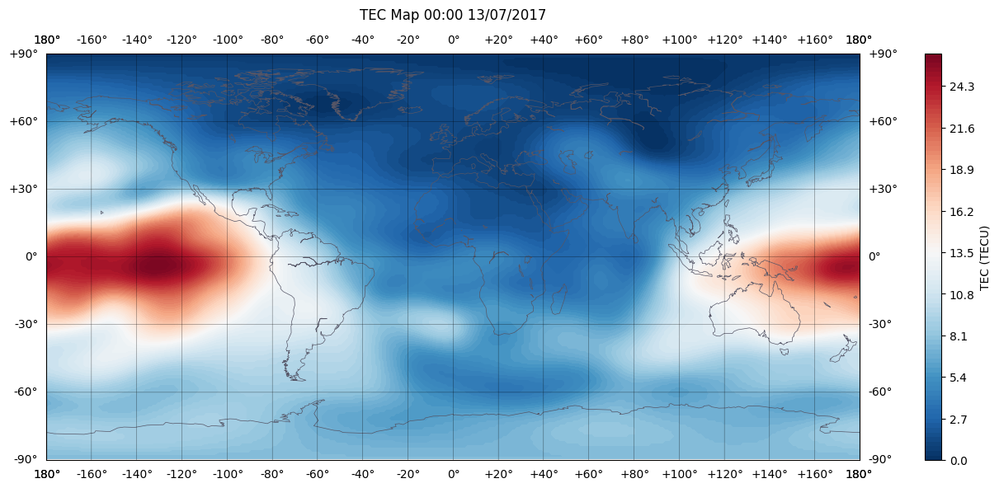

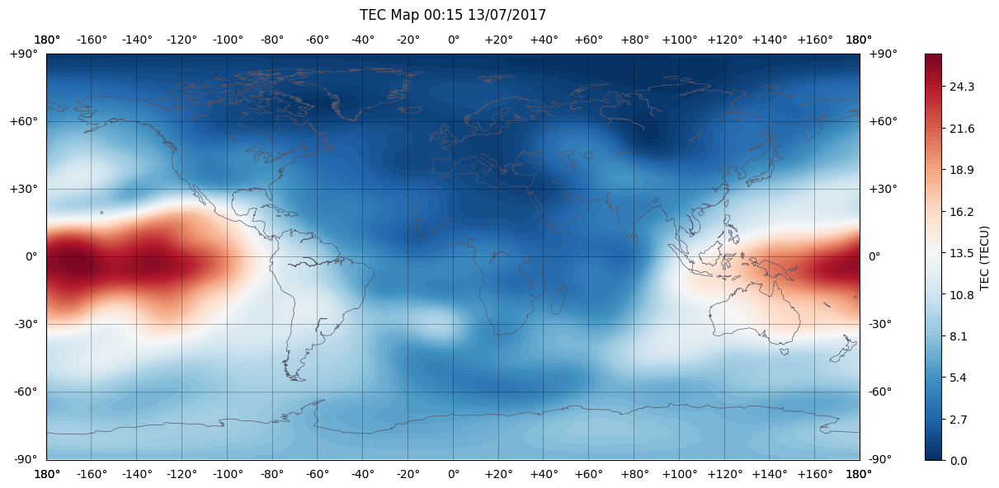

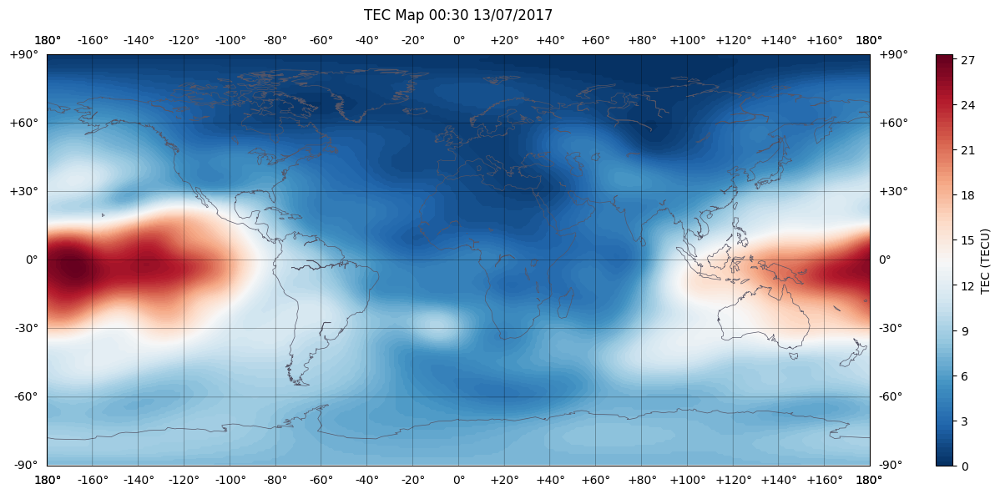

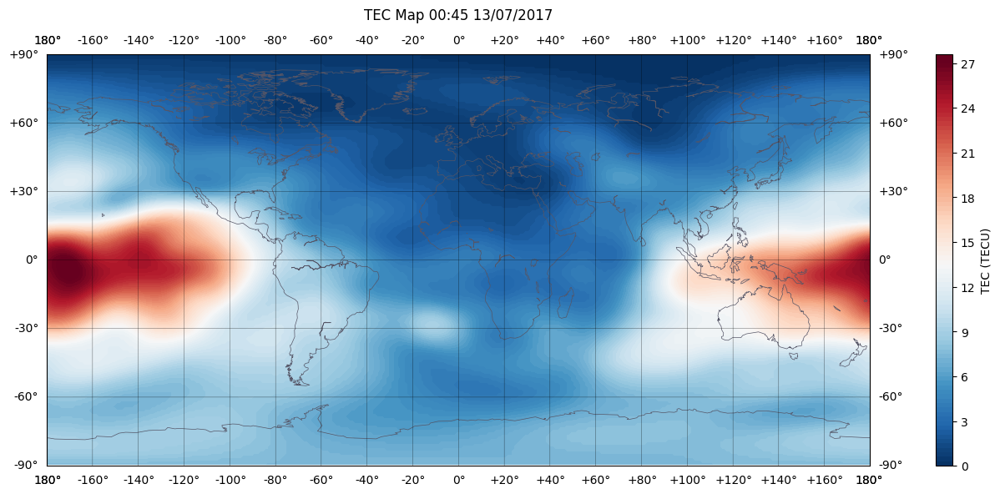

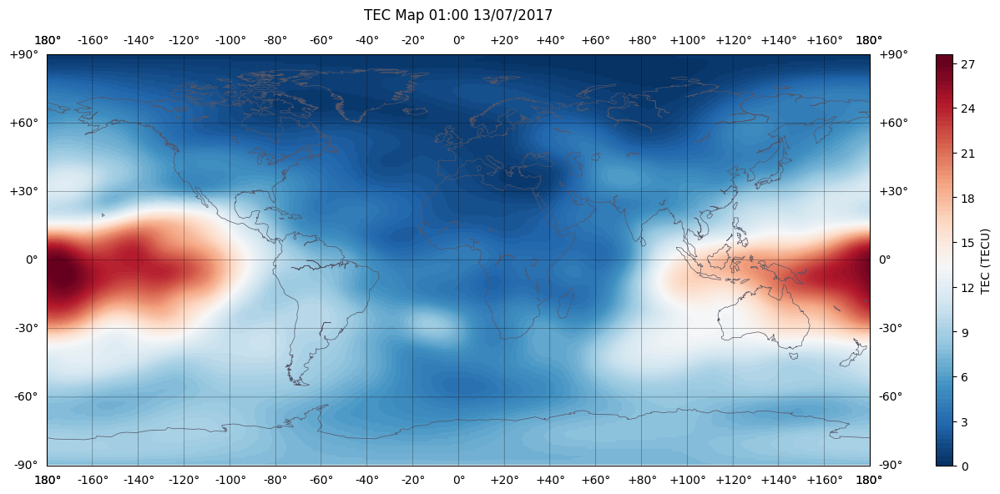

...

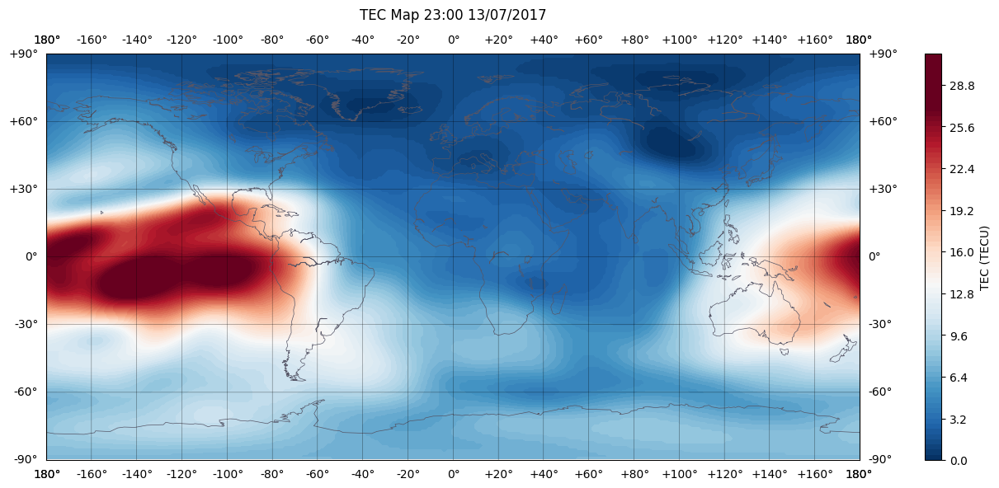

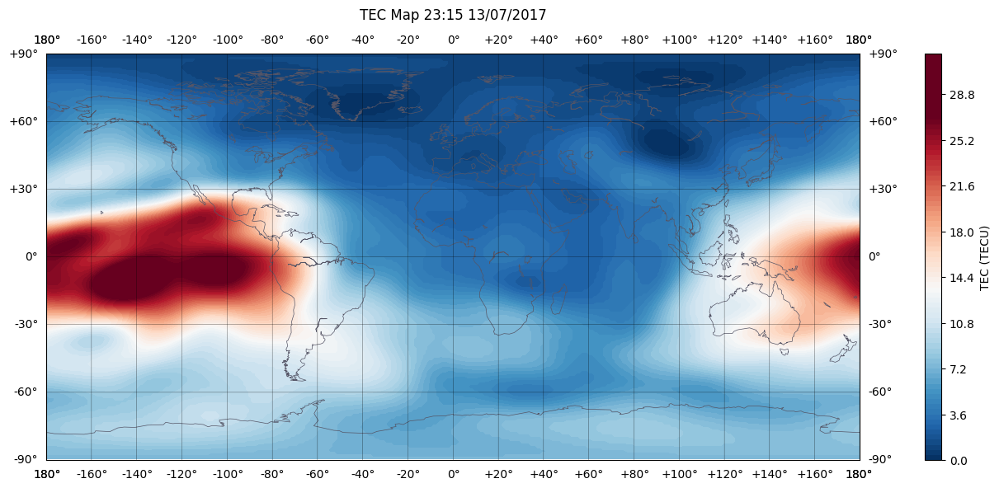

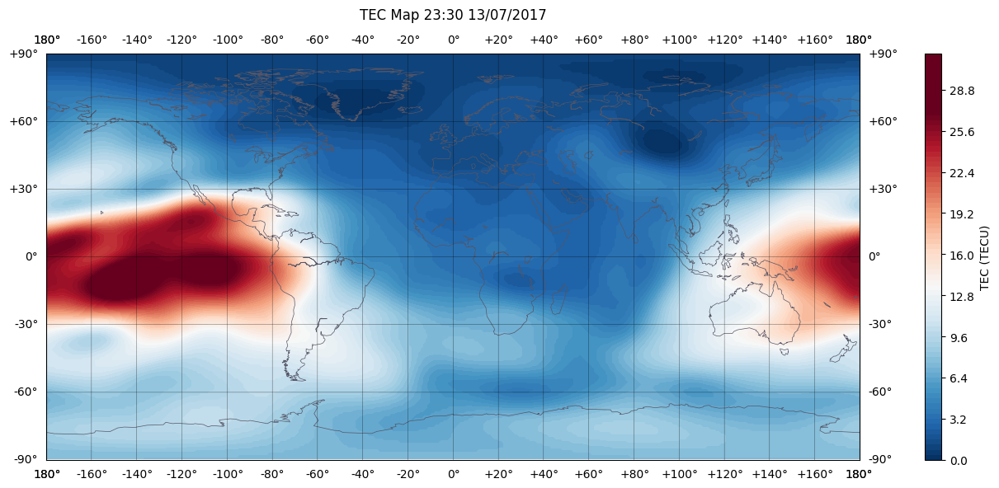

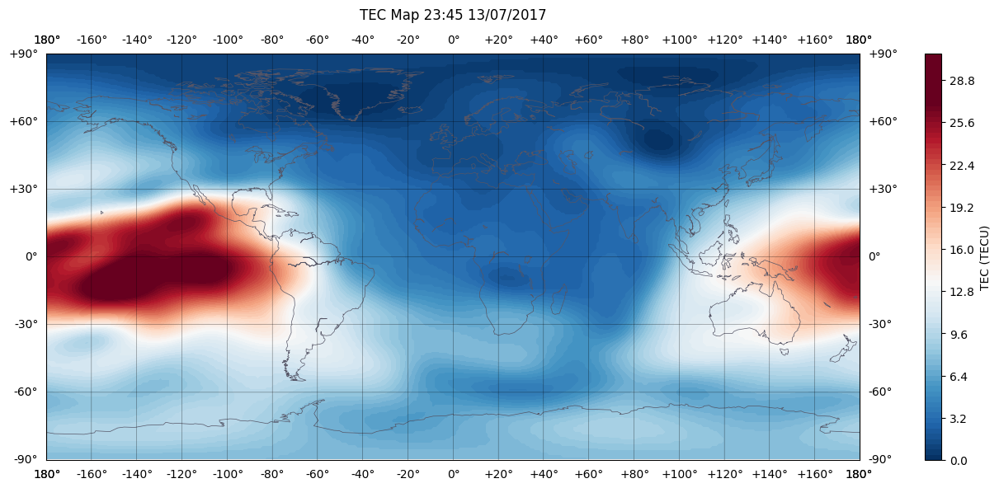

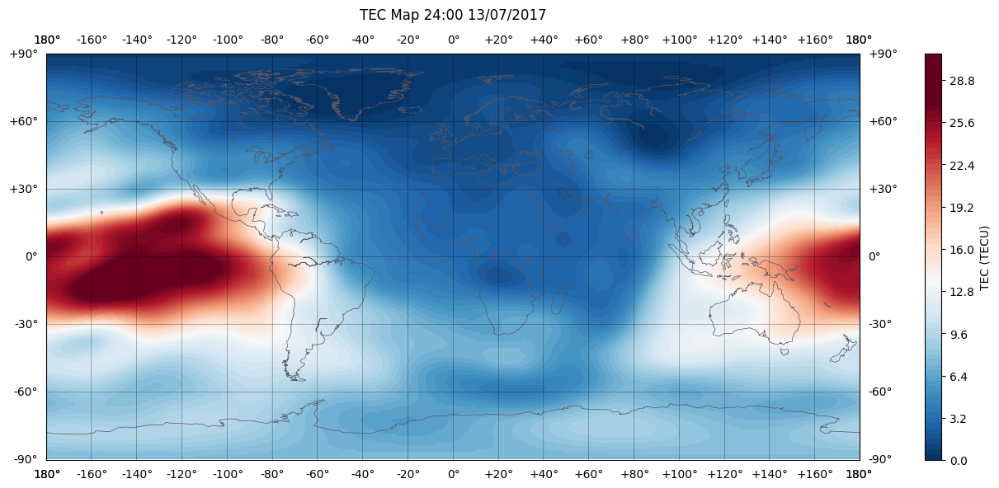

In [12]:

for i in range(97):
    time = timeslot_to_time(i)
    time_date = f'{time} 13/07/2017'

    tec_map = ds['tecmap'][i, :].data
    
    plot_TEC(tec_map, time_date, grid=True, save_fig=True)

print('Exported all TEC images')
import moviepy.editor as mpy


In [14]:

day = re.sub(illegal_char, '-', time_date.split()[-1])

fps=4

image_files = [os.path.join(plot_dir,img)
               for img in os.listdir(plot_dir)
               if img.endswith(".png")]
clip = mpy.ImageSequenceClip(image_files, fps=fps)
clip.write_videofile(os.path.join(plot_dir, f'{day}.mp4'))
clip.close()

Moviepy - Building video c:\Users\Alfon\OneDrive - Delft University of Technology\02 Second Year\BSc2 Q3\AE2224-I - Test, Analysis & Simulation\02 Code\TestAnalysisSimulation/plots/13-07-2017.mp4.
Moviepy - Writing video c:\Users\Alfon\OneDrive - Delft University of Technology\02 Second Year\BSc2 Q3\AE2224-I - Test, Analysis & Simulation\02 Code\TestAnalysisSimulation/plots/13-07-2017.mp4



Moviepy - Done !
Moviepy - video ready c:\Users\Alfon\OneDrive - Delft University of Technology\02 Second Year\BSc2 Q3\AE2224-I - Test, Analysis & Simulation\02 Code\TestAnalysisSimulation/plots/13-07-2017.mp4


In [15]:
# code to close the dataset and delete the files in temp

ds.close()

shutil.rmtree(temp_dir)

### Playing with `.netCDF4` files

In [ ]:
ds

In [11]:
tec = ds['tecmap']
tec

<class 'netCDF4._netCDF4.Variable'>
float32 tecmap(time, lat, lon)
    units: TECU (1x10^16 el m-2)
    coordinates: time lat lon
unlimited dimensions: 
current shape = (97, 180, 360)
filling on, default _FillValue of 9.969209968386869e+36 used

In [ ]:
plt.contourf(tec)

In [ ]:
type(tec)

see [Masked Array](https://numpy.org/doc/stable/reference/maskedarray.baseclass.html#numpy.ma.MaskedArray) docs:
- `fill_value` is the value that is added on entires with missing data 

In [ ]:
# see if there is any time step with a mask
mask = False
for t in range(0, 97):
    tec = ds['tecmap'][t,:]
    if tec.mask != False:
        print(t)
        mask = True

print(mask)

## Testing

In [ ]:
import gim_tools

gim_tools.find_mac()